# Some global settings and imports

In [2]:
import os
import math
import pickle
import librosa
import numpy as np
import soundfile as sf
import librosa.display
import matplotlib.pyplot as plt

from pyAudioAnalysis import audioSegmentation as aS
from tqdm import tqdm

In [3]:
SPLIT_DATA_DIR = '../split_data'
AMBIENT_RECORDING = '../raw_data/ambient.wav'

# Librosa default load frequency: 22.050 Hz
# 0.5s @ 22.050 Hz = 11.025 data points
WINDOW_SIZE = 11025

# Preprocess Bell Sounds

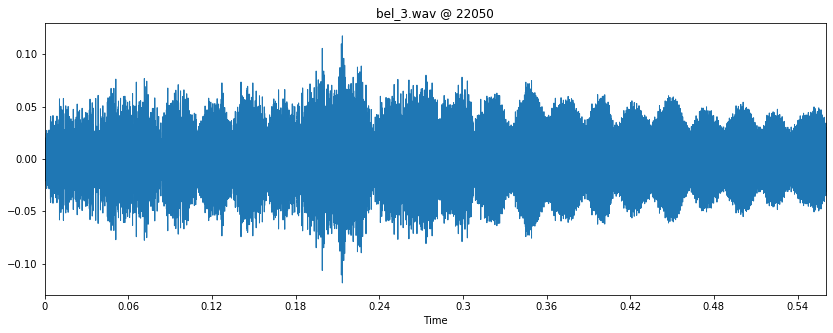

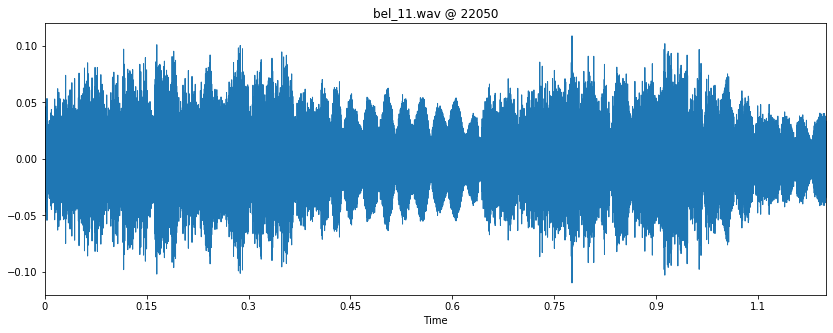

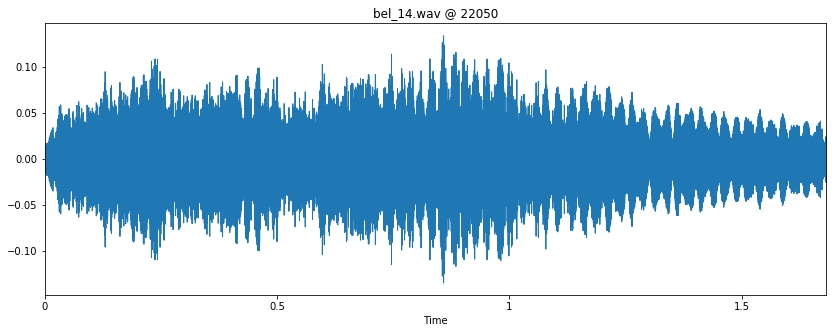

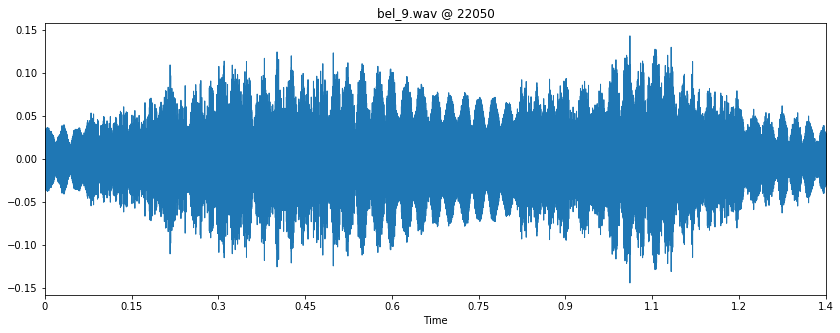

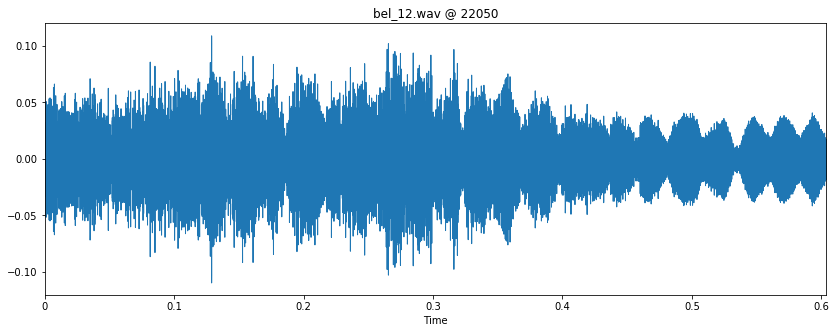

...

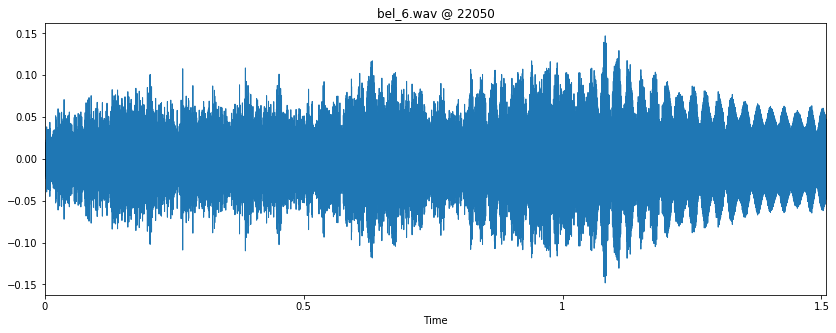

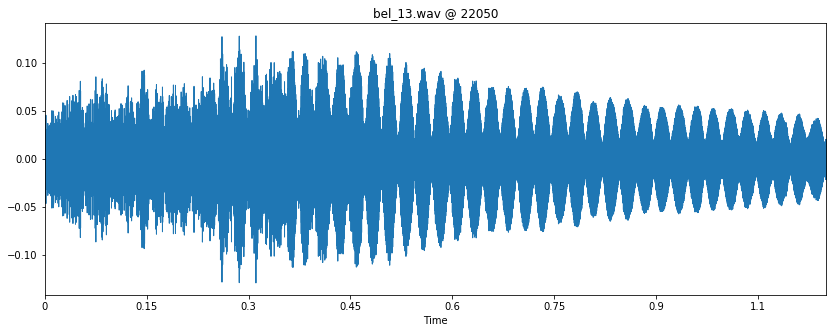

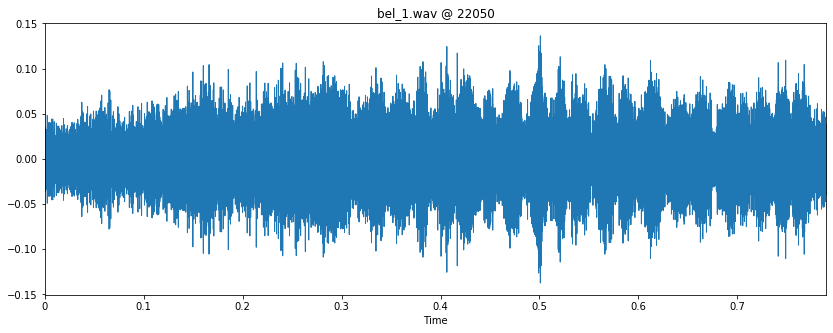

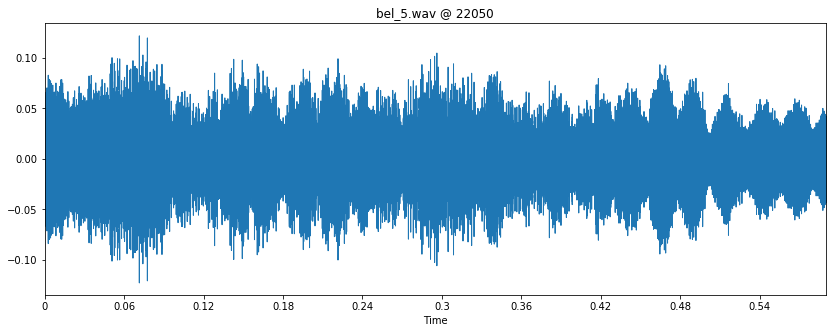

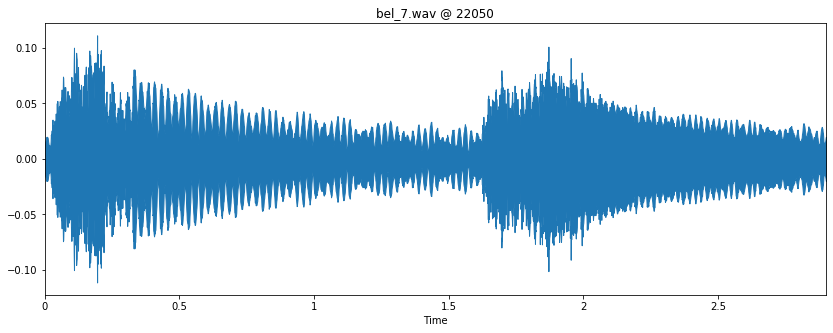

In [4]:
bell_clips = []
split_bells_path = os.path.join(SPLIT_DATA_DIR, 'bell')

# Read all bell sounds and plot them as a sanity check
for bell_name in os.listdir(split_bells_path):
    x , sr = librosa.load(os.path.join(split_bells_path, bell_name))
    bell_clips.append(x)
    plt.figure(figsize=(14, 5))
    plt.title(f'{bell_name} @ {sr}')
    librosa.display.waveplot(x, sr=sr)

In [5]:
# Print some dimensions as a sanity check, check if these values make sense
print(len(bell_clips))
print(bell_clips[0])
print(bell_clips[0].shape)

15
[-0.01297442 -0.01757553 -0.01590165 ... -0.01975056 -0.01978751
 -0.03017062]
(12357,)


In [6]:
# Step size: every 0.25 seconds = 5512 data points
skip = 5512

bell_windows = []
for clip in bell_clips:
    n_skips = math.floor((len(clip) - WINDOW_SIZE) / skip)
    for n in range(WINDOW_SIZE, WINDOW_SIZE + (n_skips + 1) * skip, skip):
        bell_windows.append(clip[n - WINDOW_SIZE:n].copy())
print(len(bell_windows))

47


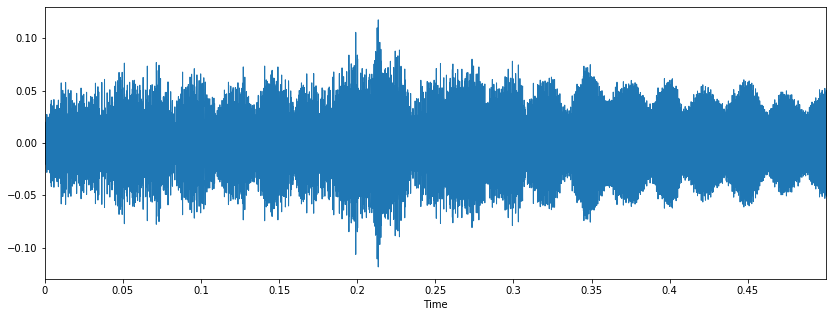

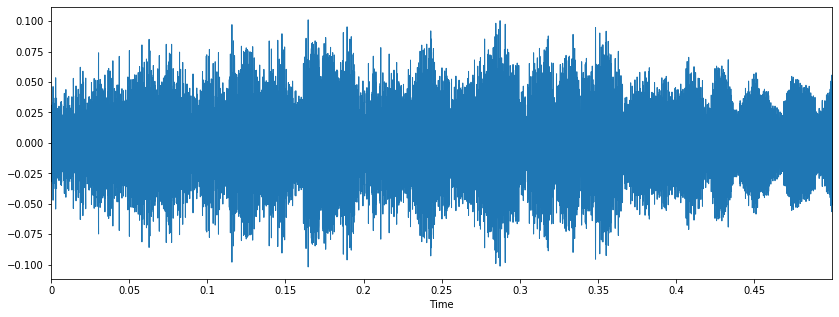

In [7]:
# Every window should now be 0.5 seconds long
for window in bell_windows[:2]:
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(window, sr=sr)

# Cutting Up Ambient Sounds

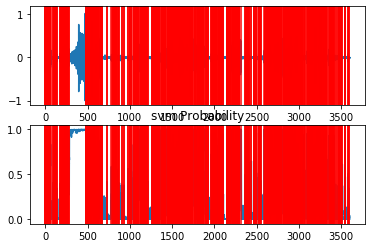

In [8]:
# This can take a while depending on the size of the ambient recording and your computer
# It will return a list of lists containing the start and end segments of pieces of audio
# containing more than just silence

ambient , sr = librosa.load(AMBIENT_RECORDING)
segments = aS.silence_removal(ambient, sr, 0.020, 0.020, smooth_window = 1.0, weight = 0.3, plot = True)

# Preprocessing Ambient Sounds

In [9]:
ambient_clips = []
for i, (start, stop) in enumerate(segments):
    segment = ambient[int(start * sr): int(stop * sr)]
    ambient_clips.append(segment)

In [10]:
# No need here to use a step smaller than the original window, we should have more than enough data here
skip = WINDOW_SIZE

ambient_windows = []
for clip in ambient_clips:
    n_skips = math.floor((len(clip) - WINDOW_SIZE) / skip)
    for n in range(WINDOW_SIZE, WINDOW_SIZE + (n_skips + 1) * skip, skip):
        ambient_windows.append(clip[n - WINDOW_SIZE:n].copy())

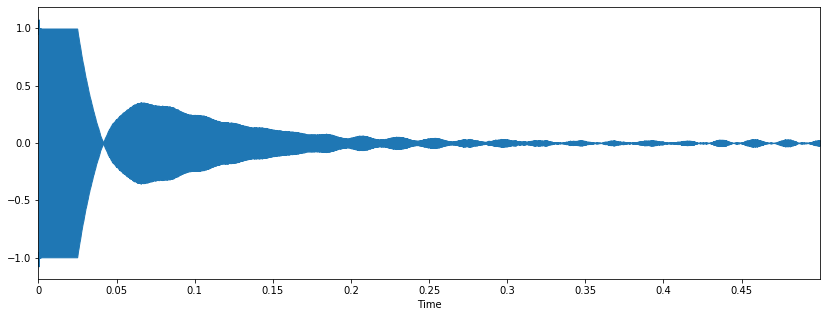

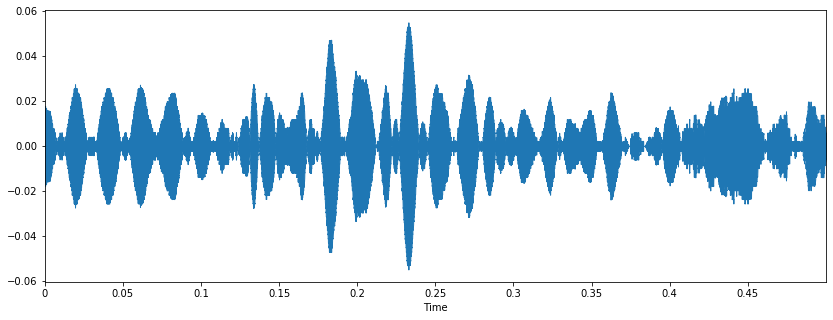

In [11]:
# Every window should now be 0.5 seconds long
for window in ambient_windows[:2]:
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(window, sr=sr)

In [12]:
bell_data = np.array(bell_windows)
ambient_data = np.array(ambient_windows)

bell_data.shape, ambient_data.shape

((47, 11025), (2682, 11025))

In [13]:
np.save(open('../deploy/data/original/bell_data.npy', 'wb'), bell_data)
np.save(open('../deploy/data/original/ambient_data.npy', 'wb'), ambient_data)

# Training

In [14]:

import pickle
import numpy as np
import pandas as pd
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from confusion_matrix_pretty_print import plot_confusion_matrix_from_data

## Preparing

In [15]:
# Take only the 100 first examples of noise
np.random.shuffle(ambient_data)
ambient_data = ambient_data[:100]

print(ambient_data.shape, bell_data.shape)

(100, 11025) (47, 11025)


In [16]:
def calc_mfcc(data):
    mfccs = [np.mean(librosa.feature.mfcc(y=entry, sr=sr, n_mfcc=13).T, axis=0) for entry in data]
    return np.array(mfccs)

bell_mfcc = calc_mfcc(bell_data)
ambient_mfcc = calc_mfcc(ambient_data)

features = np.vstack([bell_mfcc, ambient_mfcc])
labels = np.vstack([1]*len(bell_mfcc) + [0]*len(ambient_mfcc))

print(bell_mfcc.shape, ambient_mfcc.shape, features.shape)

(47, 13) (100, 13) (147, 13)


In [17]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

In [18]:
def algorithm_pipeline(X_train_data, X_test_data, y_train_data, y_test_data, 
                       model, param_grid, cv=5, scoring_fit='neg_mean_squared_error',
                       do_probabilities = False):
    gs = GridSearchCV(
        estimator=model,
        param_grid=param_grid, 
        cv=cv, 
        n_jobs=-1, 
        scoring=scoring_fit,
        verbose=3
    )
    fitted_model = gs.fit(X_train_data, y_train_data)
    
    if do_probabilities:
      pred = fitted_model.predict_proba(X_test_data)
    else:
      pred = fitted_model.predict(X_test_data)
    
    return fitted_model, pred

## Random Forest

Fitting 5 folds for each of 27 candidates, totalling 135 fits
1.0
{'max_depth': 15, 'max_leaf_nodes': 50, 'n_estimators': 400}


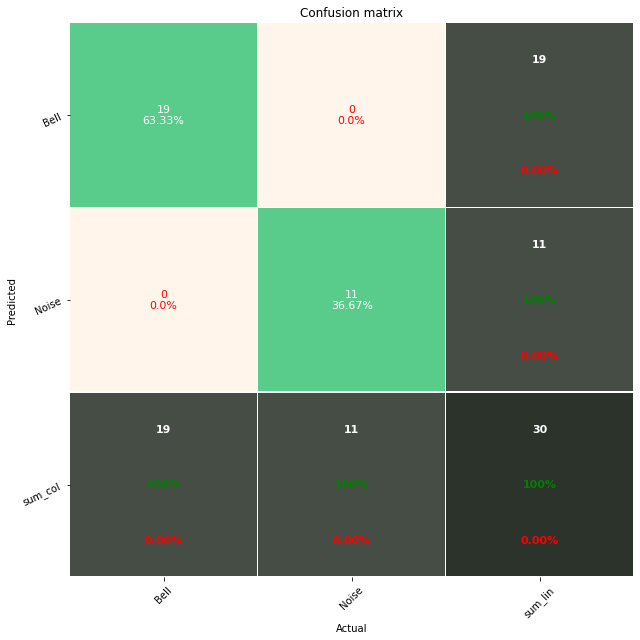

In [19]:
model = RandomForestClassifier()
param_grid = {
    'n_estimators': [400, 700, 1000],
    'max_depth': [15,20,25],
    'max_leaf_nodes': [50, 100, 200]
}

model, pred = algorithm_pipeline(X_train, X_test, y_train, y_test, model, 
                                 param_grid, cv=5, scoring_fit='accuracy')

print(model.best_score_)
print(model.best_params_)
plot_confusion_matrix_from_data(y_test, pred, columns=['Bell', 'Noise'])

Fitting 5 folds for each of 12 candidates, totalling 60 fits
1.0
{'C': 1, 'gamma': 0.001, 'kernel': 'rbf'}


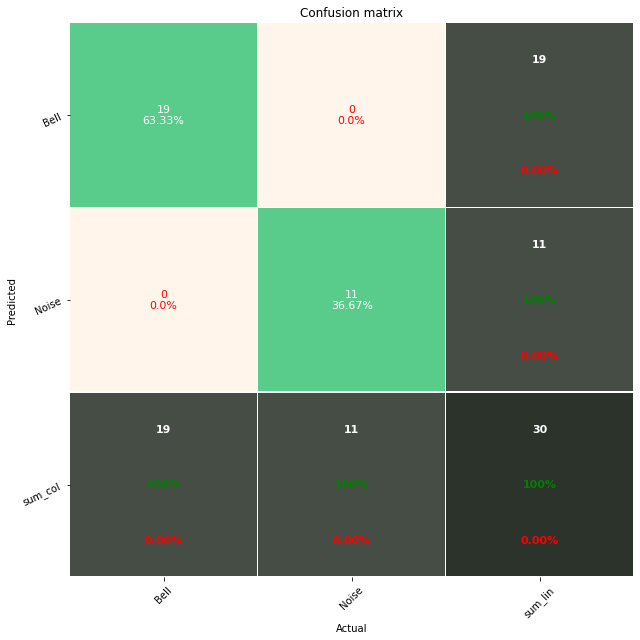

In [20]:
model = SVC()
param_grid = [
    {'kernel': ['rbf'],
    'gamma': [1e-3, 1e-4],
    'C': [1, 10, 100, 1000]},
    {'kernel': ['linear'],
    'C': [1, 10, 100, 1000]}
]

model, pred = algorithm_pipeline(X_train, X_test, y_train, y_test, model, 
                                 param_grid, cv=5, scoring_fit='accuracy')

print(model.best_score_)
print(model.best_params_)
plot_confusion_matrix_from_data(y_test, pred, columns=['Bell', 'Noise'])

In [21]:
pickle.dump(model, open('SVC.p', 'wb'))